Code for **"Blind restoration of a JPEG-compressed image"** and **"Blind image denoising"** figures. Select `fname` below to switch between the two.

- To see overfitting set `num_iter` to a large value.

In [1]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/mitsuhazuki/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 437, done.
remote: Counting objects: 100% (148/148), done.
remote: Compressing objects: 100% (106/106), done.
remote: Total 437 (delta 57), reused 110 (delta 40), pack-reused 289
Receiving objects: 100% (437/437), 382.49 MiB | 9.42 MiB/s, done.
Resolving deltas: 100% (212/212), done.
Updating files: 100% (65/65), done.


# Import libs

In [13]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
from models import *

import torch
import torch.optim

from skimage.metrics import peak_signal_noise_ratio
from utils.denoising_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

imsize =-1
PLOT = True
sigma = 25
sigma_ = sigma/255.

In [6]:
# deJPEG 
# fname = 'data/denoising/snail.jpg'

## denoising
fname = 'data/denoising/barbara.png'

# Load image

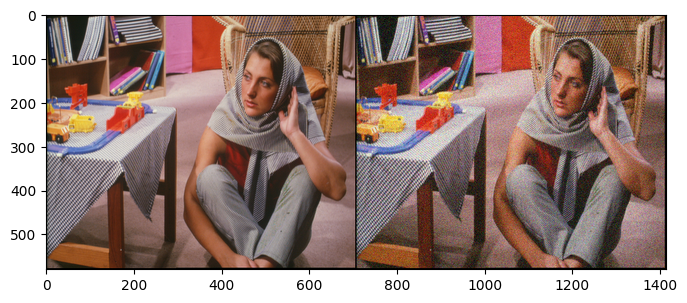

In [14]:
if fname == 'data/denoising/snail.jpg':
    img_noisy_pil = crop_image(get_image(fname, imsize)[0], d=32)
    img_noisy_np = pil_to_np(img_noisy_pil)
    
    # As we don't have ground truth
    img_pil = img_noisy_pil
    img_np = img_noisy_np
    
    if PLOT:
        plot_image_grid([img_np], 4, 5);
        
elif fname == 'data/denoising/F16_GT.png' or fname == 'data/denoising/barbara.png':
    # Add synthetic noise
    img_pil = crop_image(get_image(fname, imsize)[0], d=32)
    img_np = pil_to_np(img_pil)
    
    img_noisy_pil, img_noisy_np = get_noisy_image(img_np, sigma_)
    
    if PLOT:
        plot_image_grid([img_np, img_noisy_np], 4, 6);
else:
    assert False

# Setup

In [15]:
INPUT = 'noise' # 'meshgrid'
pad = 'reflection'
OPT_OVER = 'net' # 'net,input'

reg_noise_std = 1./30. # set to 1./20. for sigma=50
LR = 0.01

OPTIMIZER='adam' # 'LBFGS'
show_every = 100
exp_weight=0.99

if fname == 'data/denoising/snail.jpg':
    num_iter = 2400
    input_depth = 3
    figsize = 5 
    
    net = skip(
                input_depth, 3, 
                num_channels_down = [8, 16, 32, 64, 128], 
                num_channels_up   = [8, 16, 32, 64, 128],
                num_channels_skip = [0, 0, 0, 4, 4], 
                upsample_mode='bilinear',
                need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU')

    net = net.type(dtype)

elif fname == 'data/denoising/F16_GT.png' or fname == 'data/denoising/barbara.png':
    num_iter = 3000
    input_depth = 32 
    figsize = 4 
    
    
    net = get_net(input_depth, 'skip', pad,
                  skip_n33d=128, 
                  skip_n33u=128, 
                  skip_n11=4, 
                  num_scales=5,
                  upsample_mode='bilinear').type(dtype)

else:
    assert False
    
net_input = get_noise(input_depth, INPUT, (img_pil.size[1], img_pil.size[0])).type(dtype).detach()

# Compute number of parameters
s  = sum([np.prod(list(p.size())) for p in net.parameters()]); 
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_noisy_torch = np_to_torch(img_noisy_np).type(dtype)

Number of params: 2217831


# Optimize

Starting optimization with ADAM
Iteration 00000    Loss 0.076882   PSNR_noisy: 11.141777   PSRN_gt: 11.637740 PSNR_gt_sm: 11.637740

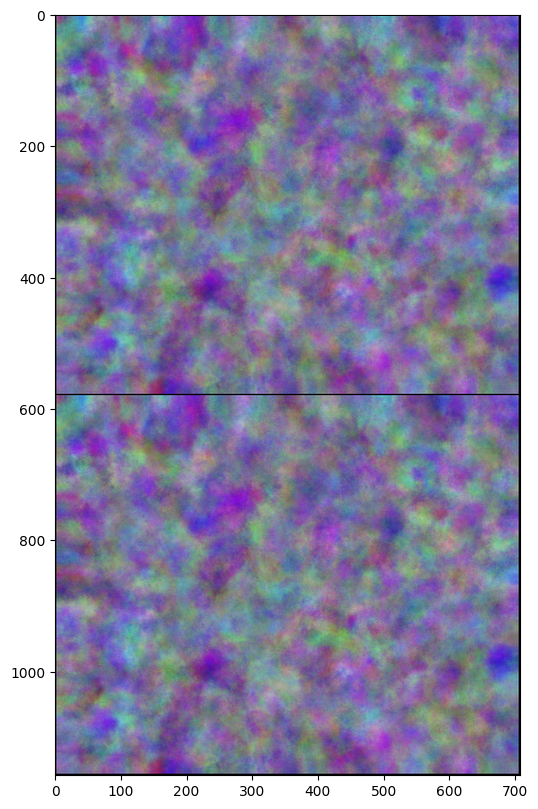

Iteration 00100    Loss 0.023039   PSNR_noisy: 16.375344   PSRN_gt: 18.545068 PSNR_gt_sm: 15.946046

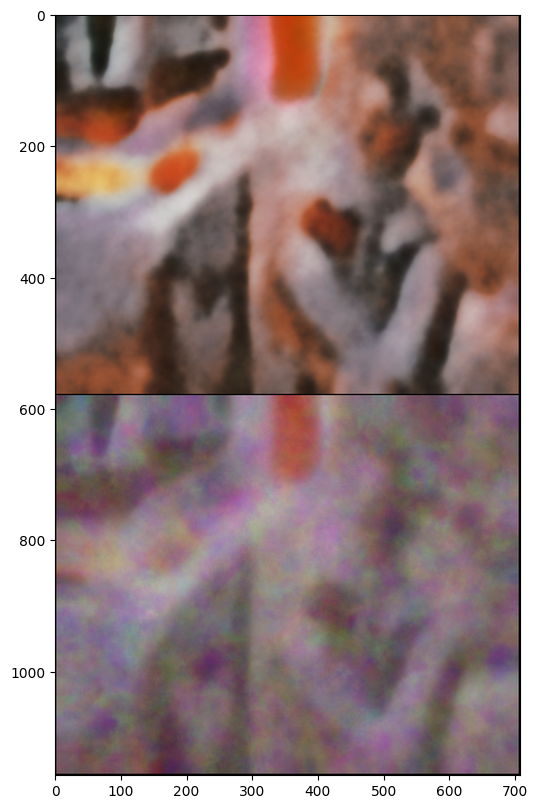

Iteration 00200    Loss 0.018485   PSNR_noisy: 17.331714   PSRN_gt: 20.277855 PSNR_gt_sm: 19.208532

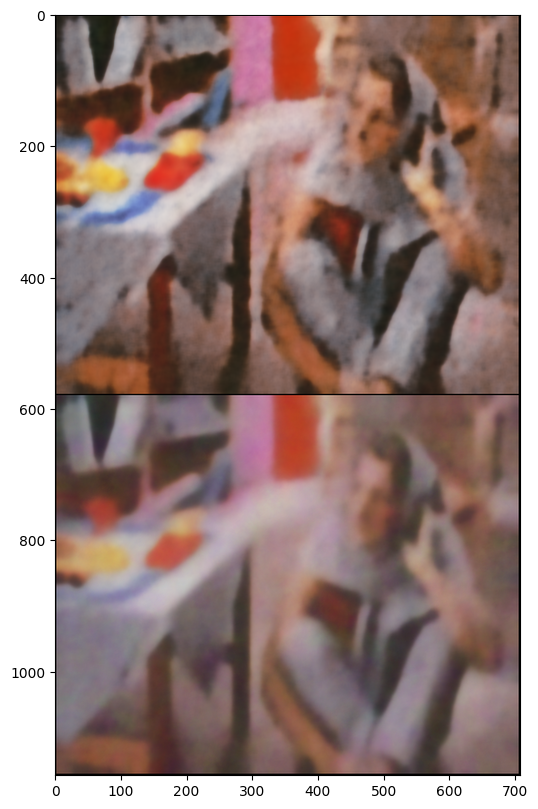

Iteration 00300    Loss 0.017036   PSNR_noisy: 17.686275   PSRN_gt: 21.022707 PSNR_gt_sm: 20.870177

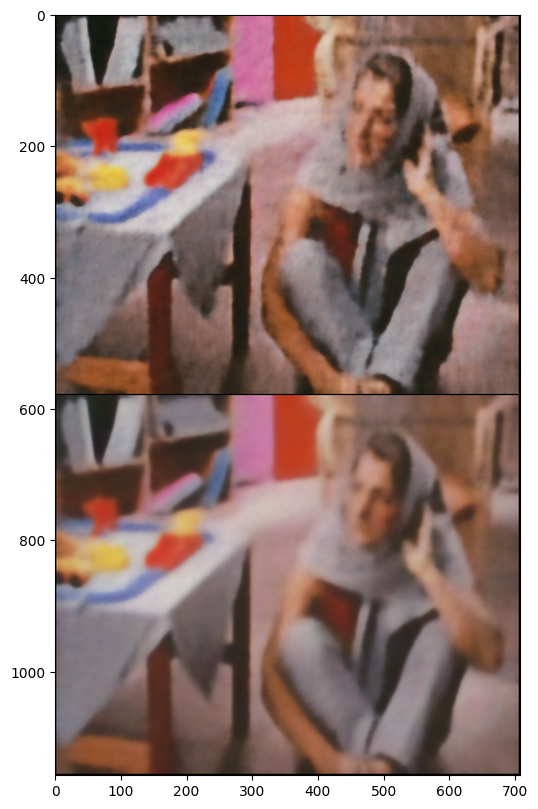

Iteration 00400    Loss 0.016043   PSNR_noisy: 17.947036   PSRN_gt: 21.599807 PSNR_gt_sm: 21.724890

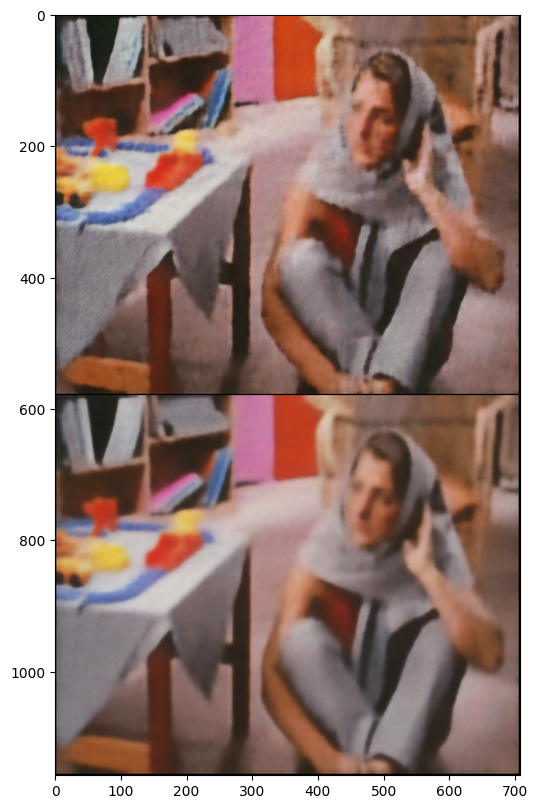

Iteration 00500    Loss 0.015305   PSNR_noisy: 18.151556   PSRN_gt: 22.077503 PSNR_gt_sm: 22.297993

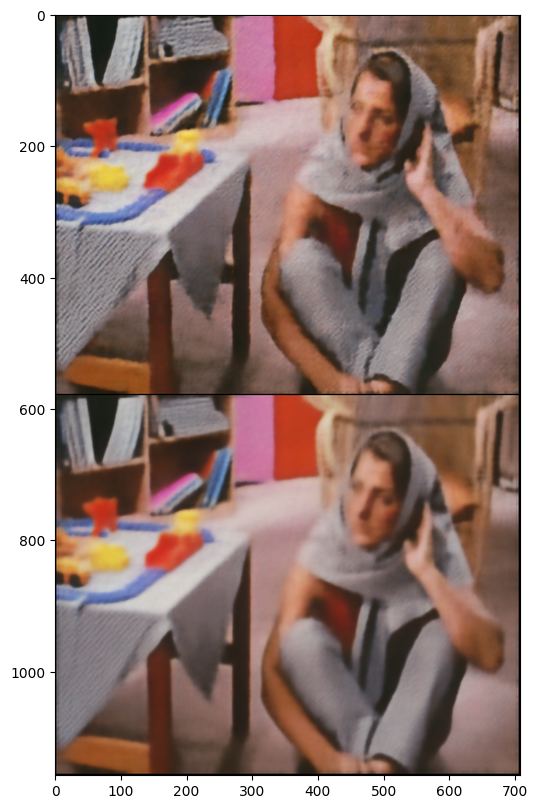

Iteration 00600    Loss 0.014448   PSNR_noisy: 18.401851   PSRN_gt: 22.715783 PSNR_gt_sm: 22.999857

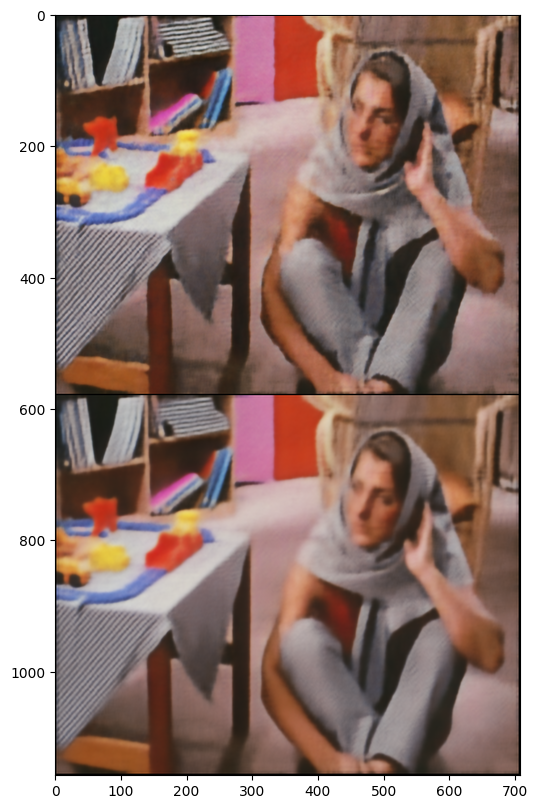

Iteration 00700    Loss 0.014004   PSNR_noisy: 18.537633   PSRN_gt: 23.081674 PSNR_gt_sm: 23.494141

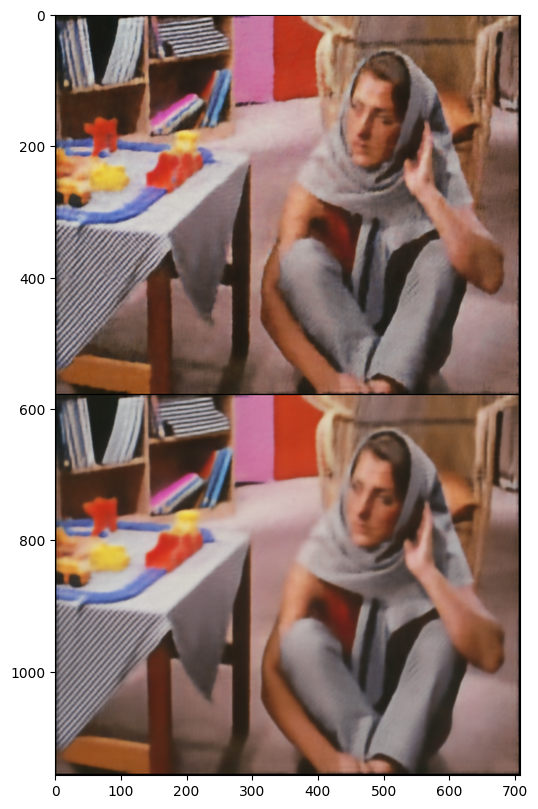

Iteration 00800    Loss 0.013654   PSNR_noisy: 18.647358   PSRN_gt: 23.385068 PSNR_gt_sm: 23.811830

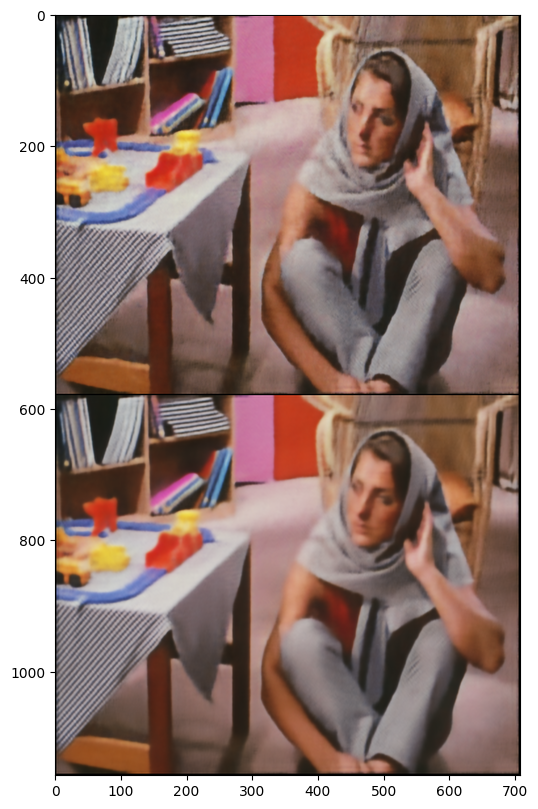

Iteration 00900    Loss 0.013386   PSNR_noisy: 18.733409   PSRN_gt: 23.621222 PSNR_gt_sm: 24.084398

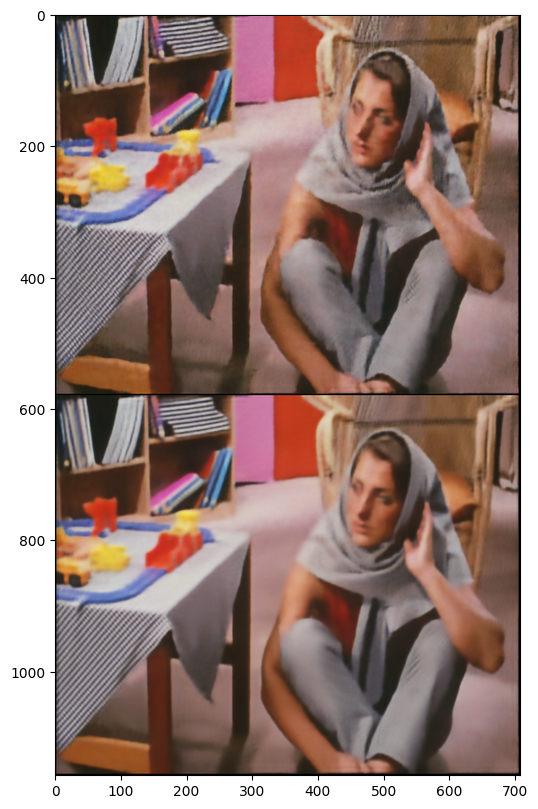

Iteration 01000    Loss 0.013121   PSNR_noisy: 18.820271   PSRN_gt: 23.897306 PSNR_gt_sm: 24.371638

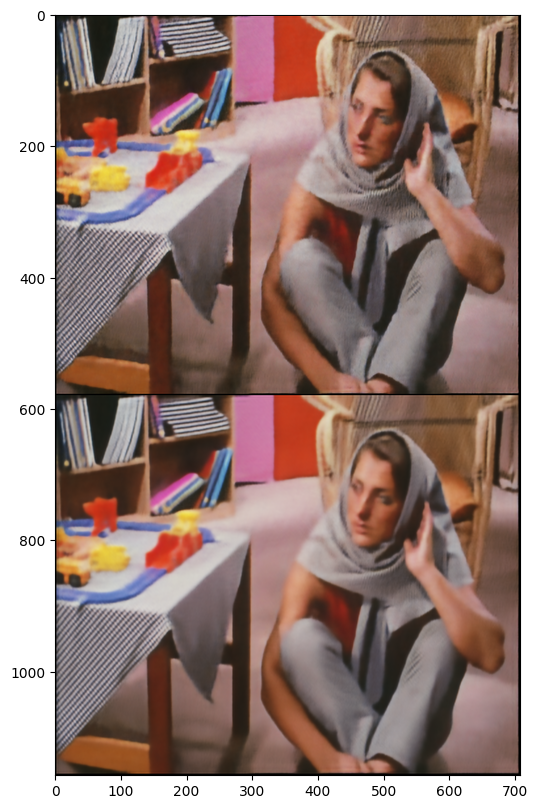

Iteration 01100    Loss 0.012819   PSNR_noisy: 18.921532   PSRN_gt: 24.193296 PSNR_gt_sm: 24.751993

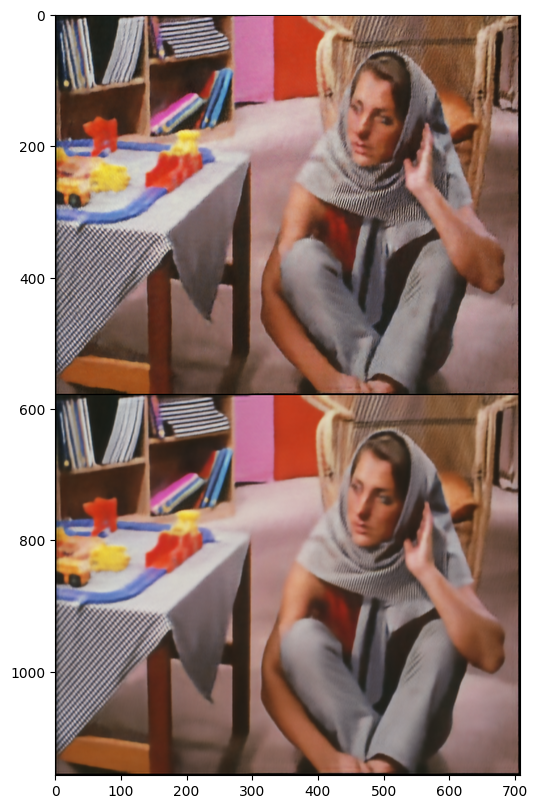

Iteration 01200    Loss 0.012498   PSNR_noisy: 19.031639   PSRN_gt: 24.554422 PSNR_gt_sm: 25.191572

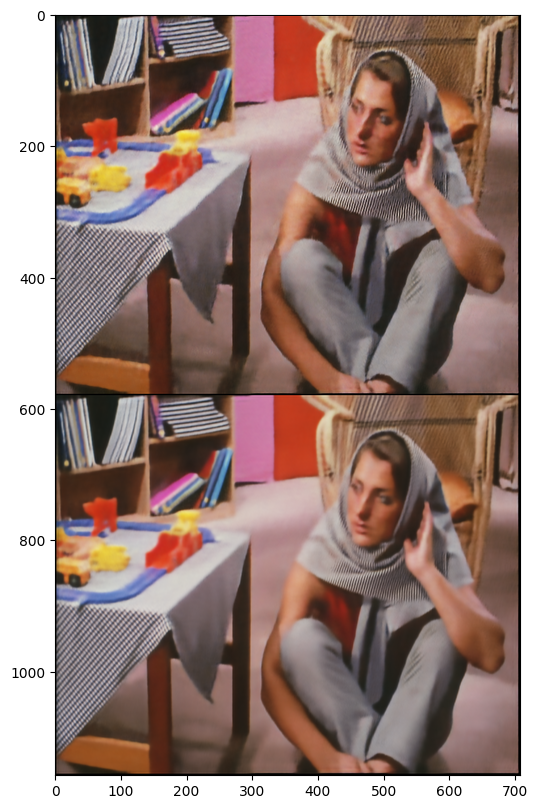

Iteration 01300    Loss 0.012334   PSNR_noisy: 19.088871   PSRN_gt: 24.741129 PSNR_gt_sm: 25.543689

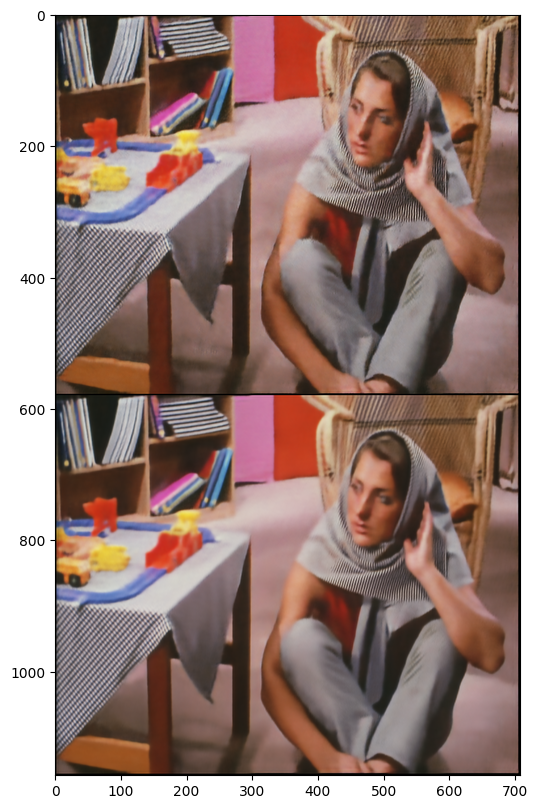

Iteration 01400    Loss 0.012064   PSNR_noisy: 19.185201   PSRN_gt: 25.086125 PSNR_gt_sm: 25.821856

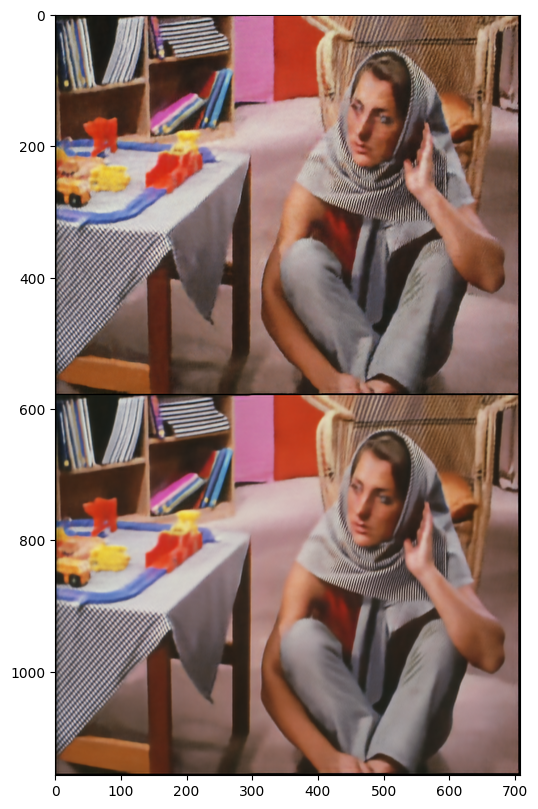

Iteration 01500    Loss 0.011928   PSNR_noisy: 19.234333   PSRN_gt: 25.260629 PSNR_gt_sm: 26.076153

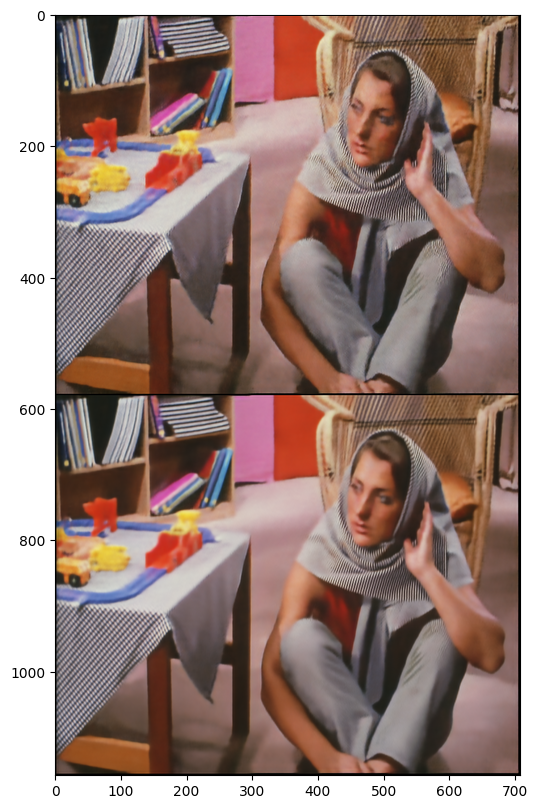

Iteration 01600    Loss 0.011798   PSNR_noisy: 19.282005   PSRN_gt: 25.412599 PSNR_gt_sm: 26.346967

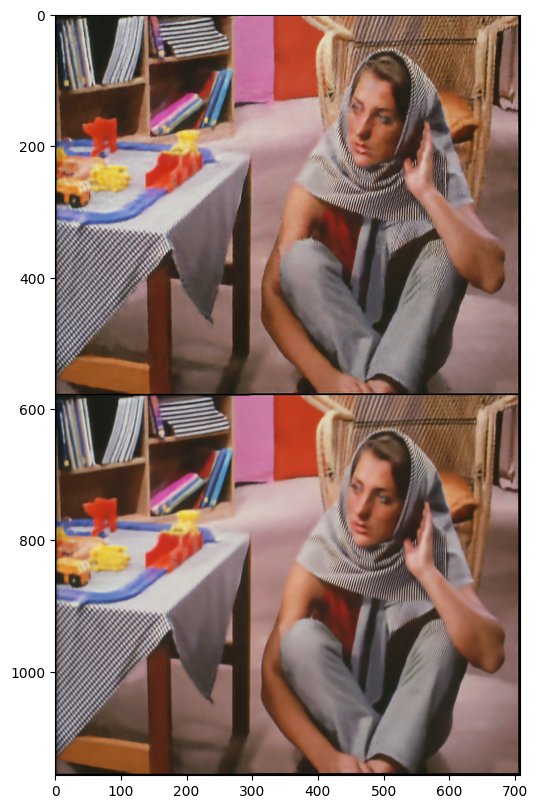

Iteration 01700    Loss 0.011741   PSNR_noisy: 19.303010   PSRN_gt: 25.480572 PSNR_gt_sm: 26.652042

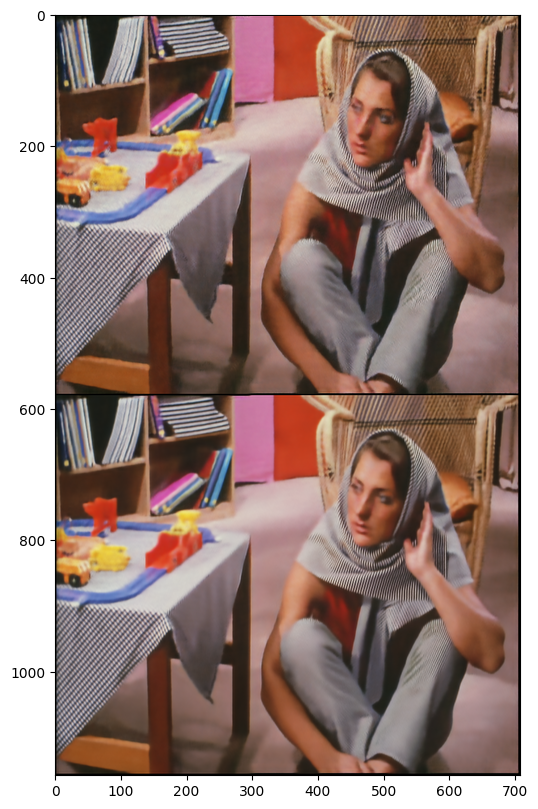

Iteration 01800    Loss 0.011543   PSNR_noisy: 19.376917   PSRN_gt: 25.750495 PSNR_gt_sm: 26.947414

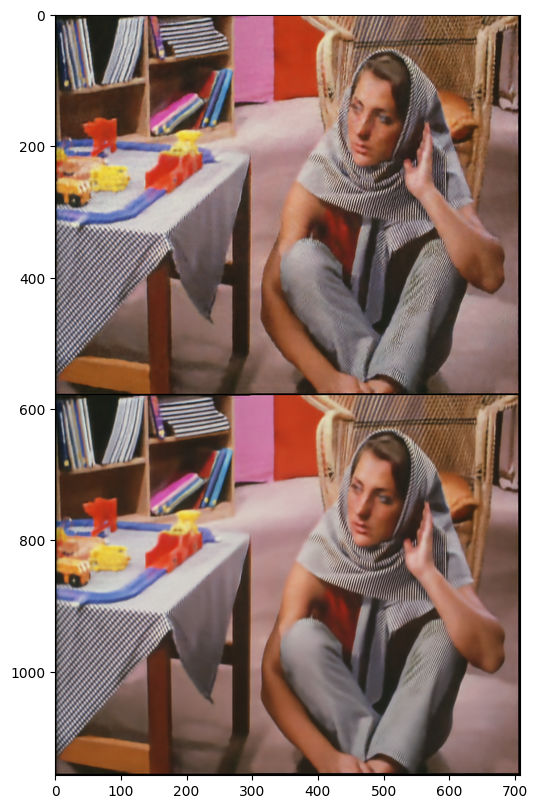

Iteration 01900    Loss 0.011206   PSNR_noisy: 19.505607   PSRN_gt: 26.302163 PSNR_gt_sm: 27.316941

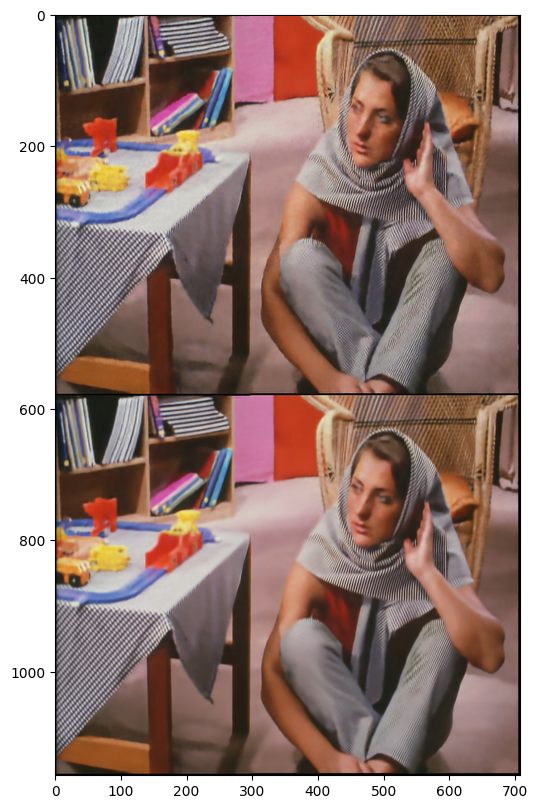

Iteration 02000    Loss 0.011003   PSNR_noisy: 19.584774   PSRN_gt: 26.627567 PSNR_gt_sm: 27.742849

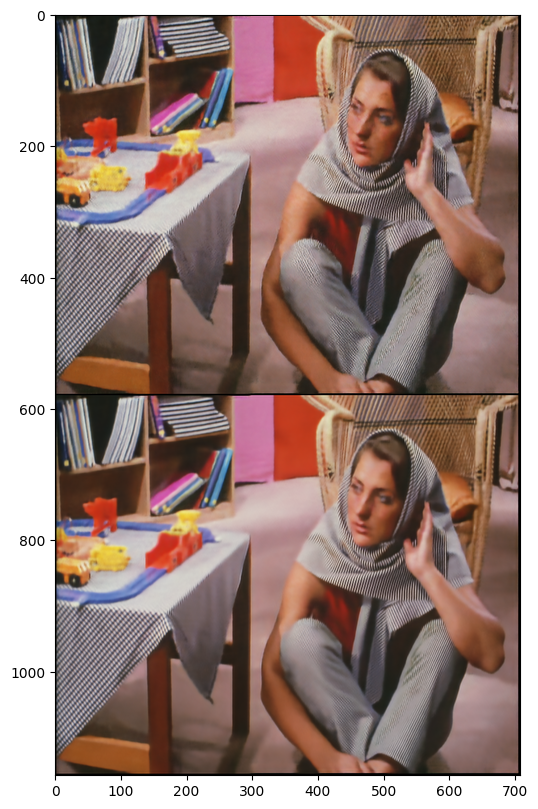

Iteration 02100    Loss 0.010892   PSNR_noisy: 19.628975   PSRN_gt: 26.843639 PSNR_gt_sm: 28.161483

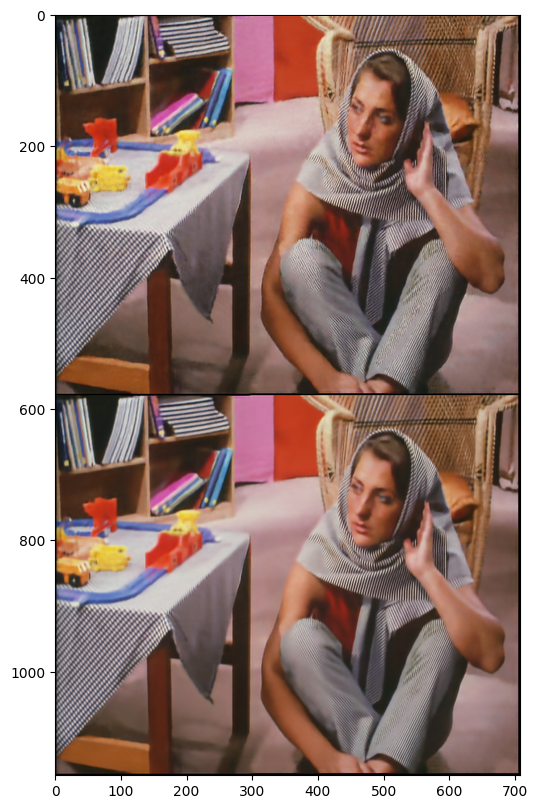

Iteration 02200    Loss 0.010731   PSNR_noisy: 19.693775   PSRN_gt: 27.123442 PSNR_gt_sm: 28.506123

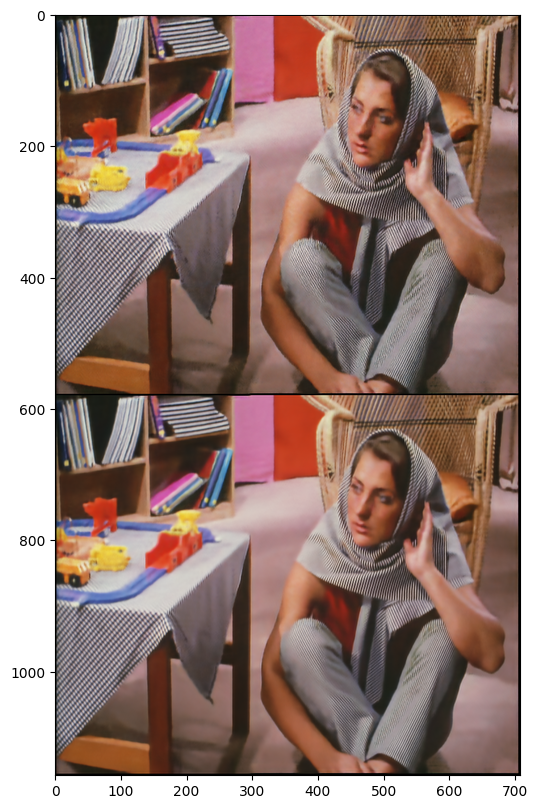

Iteration 02300    Loss 0.010595   PSNR_noisy: 19.749029   PSRN_gt: 27.384702 PSNR_gt_sm: 28.788542

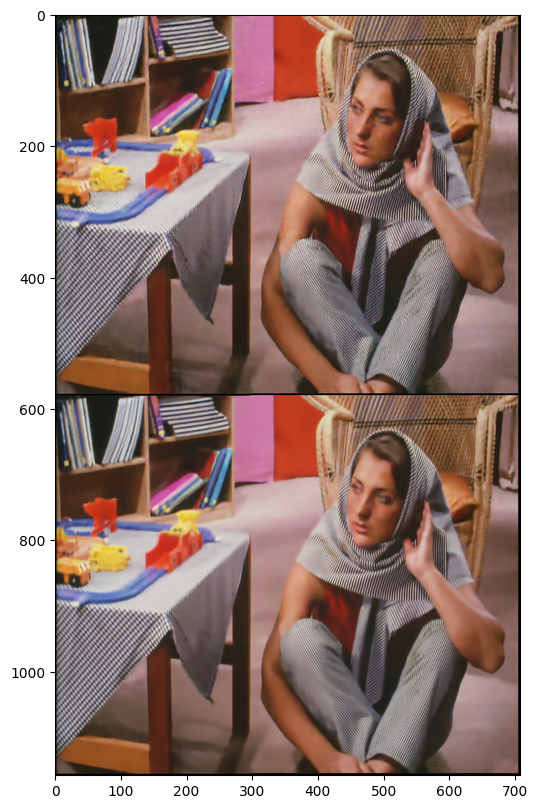

Iteration 02400    Loss 0.010521   PSNR_noisy: 19.779420   PSRN_gt: 27.491238 PSNR_gt_sm: 29.034896

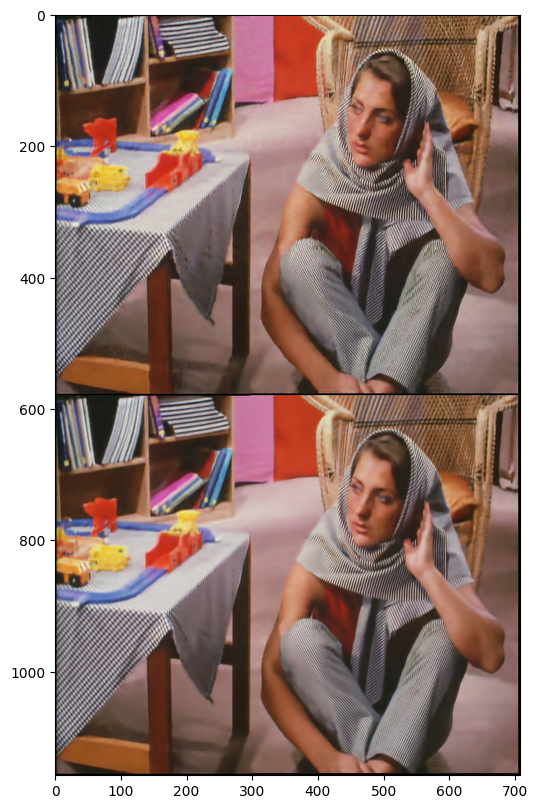

Iteration 02500    Loss 0.010426   PSNR_noisy: 19.818972   PSRN_gt: 27.655744 PSNR_gt_sm: 29.244126

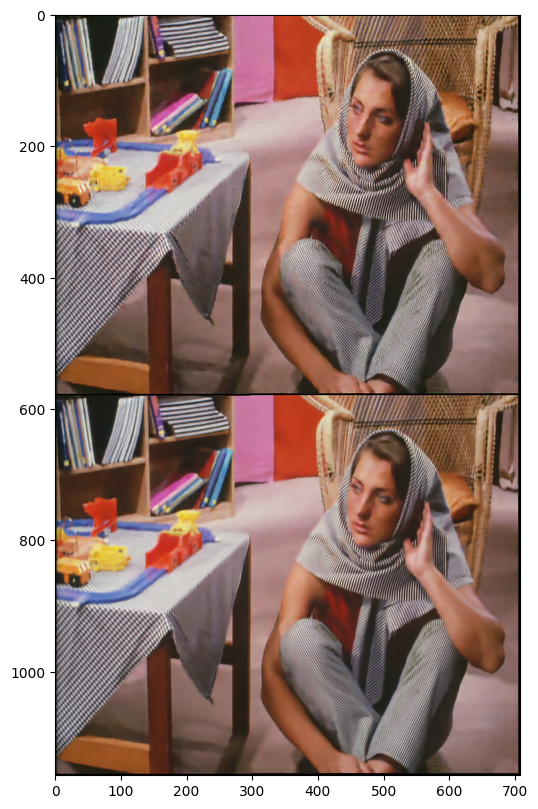

Iteration 02600    Loss 0.010343   PSNR_noisy: 19.853457   PSRN_gt: 27.782535 PSNR_gt_sm: 29.428165

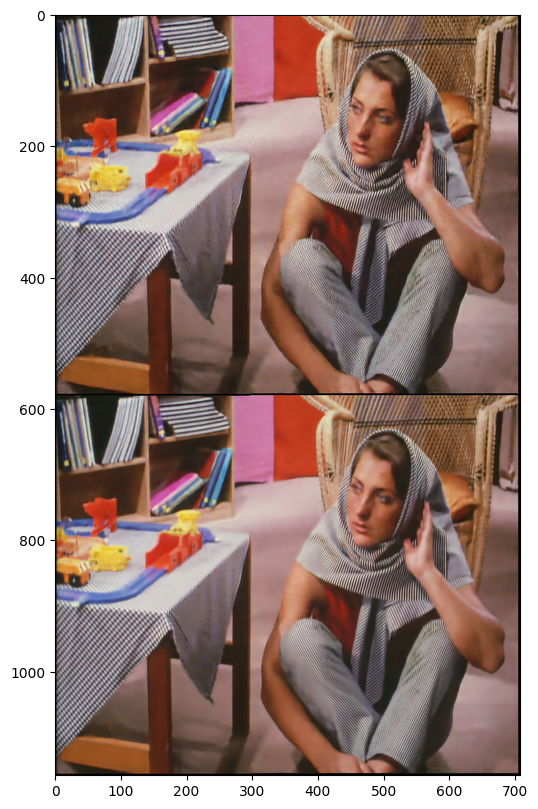

Iteration 02700    Loss 0.010252   PSNR_noisy: 19.891714   PSRN_gt: 27.900568 PSNR_gt_sm: 29.586802

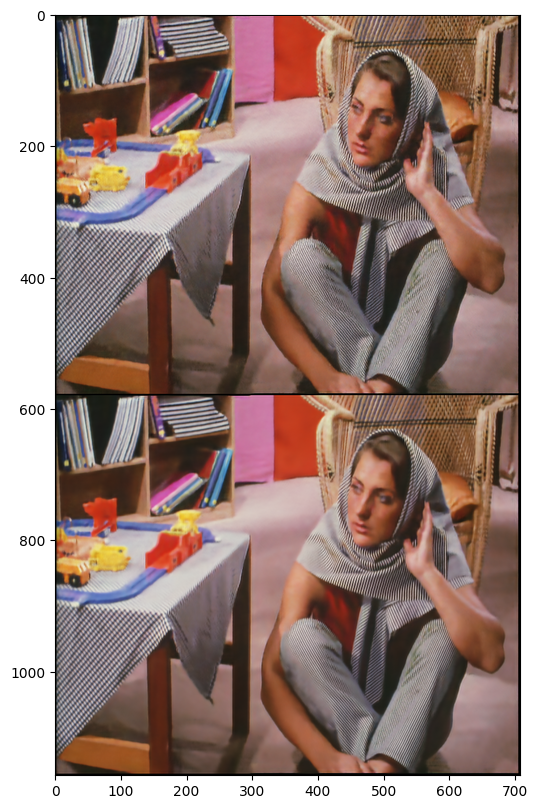

Iteration 02800    Loss 0.010200   PSNR_noisy: 19.913797   PSRN_gt: 27.964827 PSNR_gt_sm: 29.726965

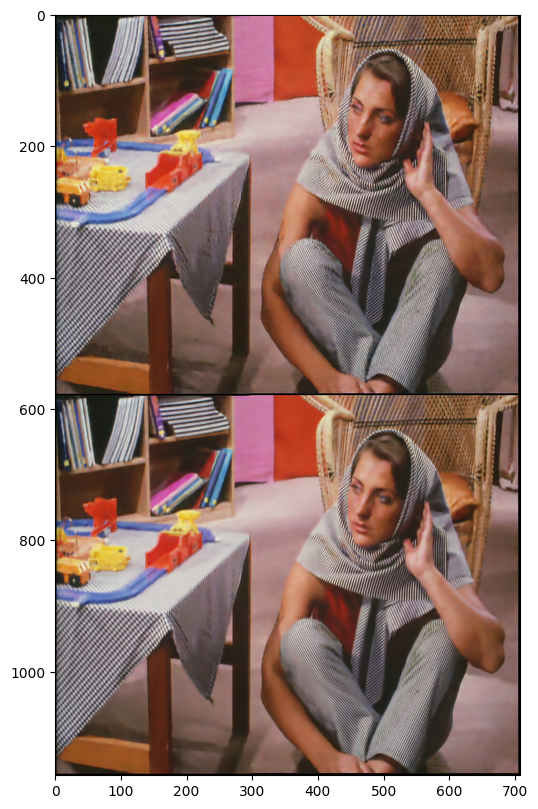

Iteration 02900    Loss 0.010139   PSNR_noisy: 19.940219   PSRN_gt: 28.059815 PSNR_gt_sm: 29.852213

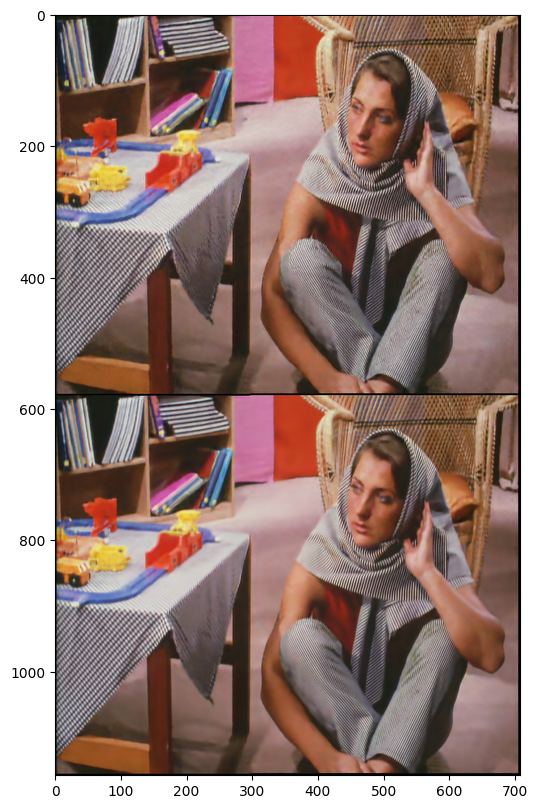

Iteration 02999    Loss 0.010160   PSNR_noisy: 19.930950   PSRN_gt: 27.877707 PSNR_gt_sm: 29.967695

In [16]:
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()
out_avg = None
last_net = None
psrn_noisy_last = 0

i = 0
def closure():
    
    global i, out_avg, psrn_noisy_last, last_net, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)
    
    # Smoothing
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)
            
    total_loss = mse(out, img_noisy_torch)
    total_loss.backward()
        
    
    psrn_noisy = peak_signal_noise_ratio(img_noisy_np, out.detach().cpu().numpy()[0]) 
    psrn_gt    = peak_signal_noise_ratio(img_np, out.detach().cpu().numpy()[0]) 
    psrn_gt_sm = peak_signal_noise_ratio(img_np, out_avg.detach().cpu().numpy()[0]) 
    
    # Note that we do not have GT for the "snail" example
    # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
    print ('\rIteration %05d    Loss %f   PSNR_noisy: %f   PSRN_gt: %f PSNR_gt_sm: %f' % (i, total_loss.item(), psrn_noisy, psrn_gt, psrn_gt_sm), end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1), 
                         np.clip(torch_to_np(out_avg), 0, 1)], factor=figsize, nrow=1)
        
        
    
    # Backtracking
    if i % show_every:
        if psrn_noisy - psrn_noisy_last < -5: 
            print('Falling back to previous checkpoint.')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.detach().cpu() for x in net.parameters()]
            psrn_noisy_last = psrn_noisy
            
    i += 1

    return total_loss

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

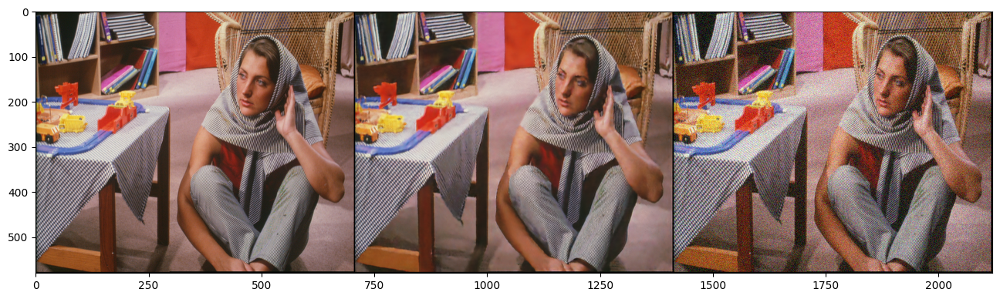

In [17]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([ img_np, np.clip(out_np, 0, 1), img_noisy_np], factor=13);

In [18]:
from scipy.io import savemat
savemat('/content/outputs.mat', {'REF': img_np, 'DET': img_noisy_np, 'output': out_np})